In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import string
from collections import Counter
from nltk.corpus import stopwords
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
import nltk
import warnings 
from wordcloud import WordCloud
from bs4 import BeautifulSoup
warnings.filterwarnings('ignore')

In [2]:
def cleaning(data):
    data['comment_text']=data['comment_text'].str.lower() #change comments to lower case
    data['comment_text']=data['comment_text'].str.replace(r'[^\w\d\s]',' ') #remove punctuation
    data['comment_text']=data['comment_text'].str.replace(r'\s+',' ') #replace whitespace   
    data['comment_text']=data['comment_text'].str.replace(r'^\s+|\s+?$',' ') #remove leading and trailing whitespace


In [3]:
def stop_clean(data):
    
    comments=list(data['comment_text'])
    comments_cleaned=[]
    for comment in comments:
        curr_comment=[]
        for word in comment.split():
            if word not in stopwords.words('english'):
                curr_comment.append(word)
        comments_cleaned.append(' '.join(curr_comment))
    data['cleaned_comments']=comments_cleaned


In [4]:
ds_train=pd.read_csv('train_cleaned.csv')
ds_test=pd.read_csv('test_cleaned.csv')
#ds_train.drop(['Unnamed','id'])

In [5]:
ds_train.drop(['Unnamed: 0','id'],axis=1, inplace=True)
ds_test.drop(['Unnamed: 0','id'],axis=1, inplace=True)

In [6]:
ds_train

,comment_text,malignant,highly_malignant,rude,threat,abuse,loathe,cleaned_comments
0,explanation why the edits made under my userna...,0,0,0,0,0,0,explanation edits made username hardcore metal...
1,d aww he matches this background colour i m se...,0,0,0,0,0,0,aww matches background colour seemingly stuck ...
2,hey man i m really not trying to edit war it s...,0,0,0,0,0,0,hey man really trying edit war guy constantly ...
3,more i can t make any real suggestions on imp...,0,0,0,0,0,0,make real suggestions improvement wondered sec...
4,you sir are my hero any chance you remember wh...,0,0,0,0,0,0,sir hero chance remember page
...,...,...,...,...,...,...,...,...
159566,and for the second time of asking when your v...,0,0,0,0,0,0,second time asking view completely contradicts...
159567,you should be ashamed of yourself that is a ho...,0,0,0,0,0,0,ashamed horrible thing put talk page 128 61 19 93
159568,spitzer umm theres no actual article for prost...,0,0,0,0,0,0,spitzer umm theres actual article prostitution...
159569,and it looks like it was actually you who put ...,0,0,0,0,0,0,looks like actually put speedy first version d...


In [7]:
ds_test

,comment_text,cleaned_comments
0,yo bitch ja rule is more succesful then you ll...,yo bitch ja rule succesful ever whats hating s...
1,from rfc the title is fine as it is imo,rfc title fine imo
2,sources zawe ashton on lapland,sources zawe ashton lapland
3,if you have a look back at the source the inf...,look back source information updated correct f...
4,i don t anonymously edit articles at all,anonymously edit articles
...,...,...
153159,i totally agree this stuff is nothing but too...,totally agree stuff nothing long crap
153160,throw from out field to home plate does it ge...,throw field home plate get faster throwing cut...
153161,okinotorishima categories i see your changes ...,okinotorishima categories see changes agree co...
153162,one of the founding nations of the eu germany...,one founding nations eu germany law return qui...


In [8]:
#0 stands for normal and 1 stands for malignant
ds_train['comment_cat']=''
for ind in ds_train.index:
    if ds_train['malignant'][ind]==0 and ds_train['highly_malignant'][ind]==0 and ds_train['rude'][ind]==0 and ds_train['threat'][ind]==0 and ds_train['abuse'][ind]==0 and ds_train['loathe'][ind]==0:
        ds_train['comment_cat'][ind]=0
        
    else:
        ds_train['comment_cat'][ind]=1
        

In [9]:
malignant=[]
highly_malignant=[]
rude=[]
threat=[]
abuse=[]
loathe=[]

for ind in ds_train.index:
    if ds_train['malignant'][ind]==1:
        malignant.append(ds_train['cleaned_comments'][ind])
for ind in ds_train.index:
    if ds_train['highly_malignant'][ind]==1:
        highly_malignant.append(ds_train['cleaned_comments'][ind])
for ind in ds_train.index:
    if ds_train['rude'][ind]==1:
        rude.append(ds_train['cleaned_comments'][ind])
for ind in ds_train.index:
    if ds_train['threat'][ind]==1:
        threat.append(ds_train['cleaned_comments'][ind])
for ind in ds_train.index:
    if ds_train['abuse'][ind]==1:
        abuse.append(ds_train['cleaned_comments'][ind])
for ind in ds_train.index:
    if ds_train['loathe'][ind]==1:
        loathe.append(ds_train['cleaned_comments'][ind])
#for ind in ds_train.index:
#    if ds_train['Normal'][ind]==1:
#        normal.append(ds_train['comment_text'][ind])#

In [10]:
def word_count(list_sent):
    for comment in list_sent:
        ctr=Counter(word_tokenize(comment,'english'))
    word_cloud=WordCloud(width=600,height=300, background_color='white',max_words=50).generate(' '.join(list_sent))
    plt.figure(figsize=(10,8),facecolor='b')
    plt.imshow(word_cloud)
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.show()
    #return word_cloud
    arr=word_cloud.to_svg()
    soup = BeautifulSoup(arr, 'html.parser')
    results = soup.find_all('text')
    words=[]
    for i in results:
        words.append(str(i.text))
    print(words)

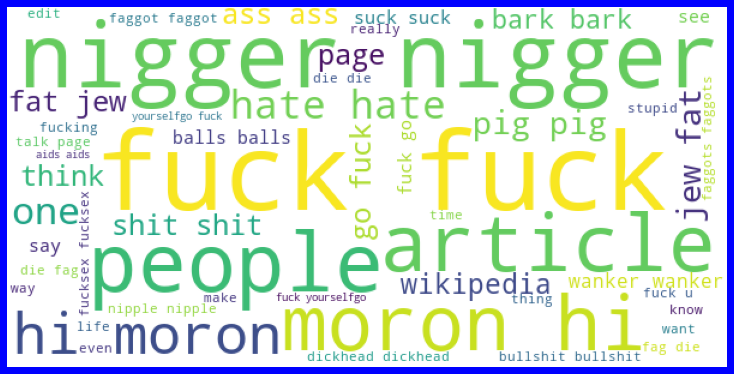

['fuck fuck', 'nigger nigger', 'people', 'article', 'moron hi', 'hi moron', 'hate hate', 'one', 'pig pig', 'jew fat', 'fat jew', 'page', 'think', 'shit shit', 'go fuck', 'ass ass', 'wikipedia', 'bark bark', 'wanker wanker', 'say', 'suck suck', 'see', 'fuck go', 'balls balls', 'bullshit bullshit', 'know', 'make', 'even', 'nipple nipple', 'faggot faggot', 'want', 'stupid', 'fucking', 'talk page', 'edit', 'life', 'time', 'way', 'fuck u', 'thing', 'die die', 'really', 'dickhead dickhead', 'die fag', 'fag die', 'faggots faggots', 'fucksex fucksex', 'fuck yourselfgo', 'yourselfgo fuck', 'aids aids']


In [11]:
word_count(malignant)

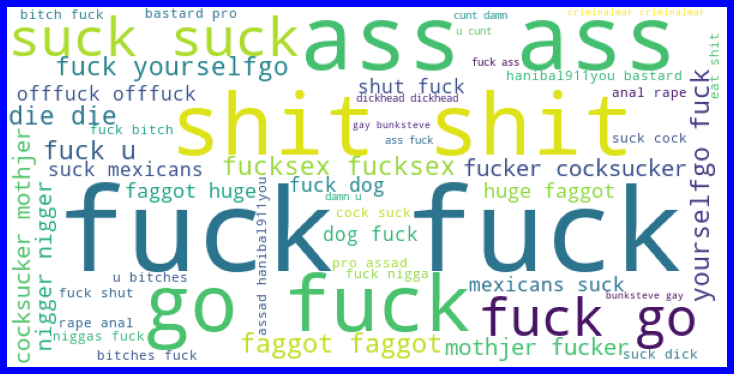

['fuck fuck', 'ass ass', 'shit shit', 'go fuck', 'suck suck', 'fuck go', 'faggot faggot', 'die die', 'fucksex fucksex', 'fuck yourselfgo', 'yourselfgo fuck', 'fuck u', 'mothjer fucker', 'fucker cocksucker', 'cocksucker mothjer', 'nigger nigger', 'huge faggot', 'faggot huge', 'shut fuck', 'offfuck offfuck', 'fuck dog', 'mexicans suck', 'suck mexicans', 'dog fuck', 'hanibal911you bastard', 'bastard pro', 'pro assad', 'fuck shut', 'assad hanibal911you', 'anal rape', 'rape anal', 'bitches fuck', 'fuck nigga', 'bitch fuck', 'fuck bitch', 'u bitches', 'niggas fuck', 'suck cock', 'suck dick', 'eat shit', 'cock suck', 'dickhead dickhead', 'u cunt', 'damn u', 'cunt damn', 'ass fuck', 'fuck ass', 'criminalwar criminalwar', 'bunksteve gay', 'gay bunksteve']


In [12]:
word_count(highly_malignant)

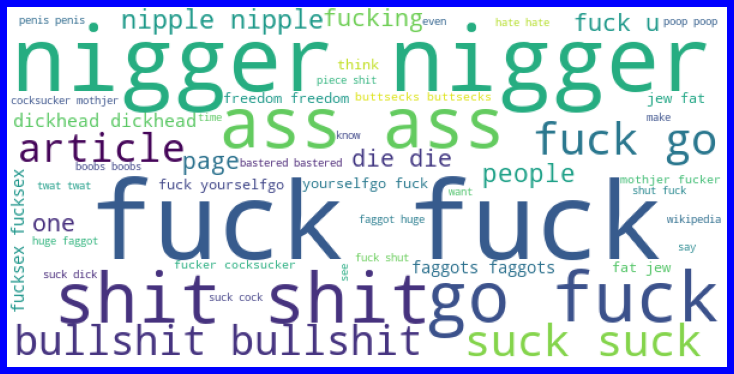

['fuck fuck', 'nigger nigger', 'shit shit', 'go fuck', 'ass ass', 'suck suck', 'fuck go', 'bullshit bullshit', 'article', 'nipple nipple', 'people', 'page', 'fuck u', 'one', 'fucking', 'die die', 'dickhead dickhead', 'faggots faggots', 'fucksex fucksex', 'fuck yourselfgo', 'yourselfgo fuck', 'think', 'jew fat', 'fat jew', 'freedom freedom', 'buttsecks buttsecks', 'mothjer fucker', 'fucker cocksucker', 'cocksucker mothjer', 'twat twat', 'wikipedia', 'shut fuck', 'bastered bastered', 'see', 'hate hate', 'poop poop', 'know', 'say', 'penis penis', 'huge faggot', 'faggot huge', 'piece shit', 'want', 'suck dick', 'time', 'make', 'fuck shut', 'suck cock', 'even', 'boobs boobs']


In [13]:
word_count(rude)

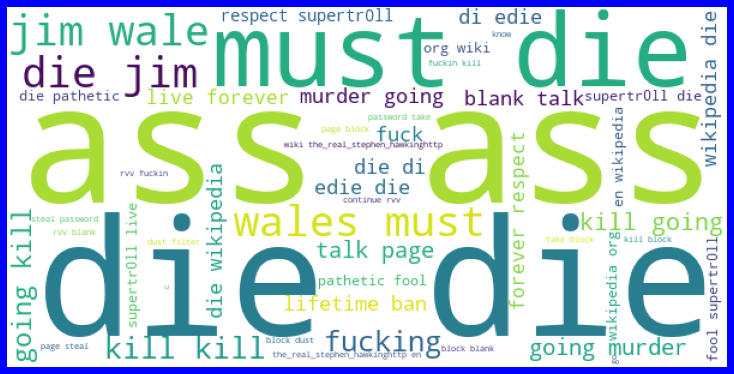

['ass ass', 'die die', 'must die', 'jim wale', 'wales must', 'die jim', 'kill kill', 'fucking', 'going kill', 'kill going', 'going murder', 'talk page', 'murder going', 'fuck', 'blank talk', 'die di', 'di edie', 'edie die', 'die wikipedia', 'wikipedia die', 'lifetime ban', 'live forever', 'forever respect', 'respect supertr0ll', 'supertr0ll die', 'die pathetic', 'supertr0ll live', 'pathetic fool', 'fool supertr0ll', 'en wikipedia', 'wikipedia org', 'org wiki', 'wiki the_real_stephen_hawkinghttp', 'the_real_stephen_hawkinghttp en', 'go', 'u', 'fuckin kill', 'dust filter', 'kill block', 'rvv fuckin', 'block blank', 'page steal', 'steal password', 'password take', 'take block', 'block dust', 'know', 'continue rvv', 'rvv blank', 'page block']


In [14]:
word_count(threat)

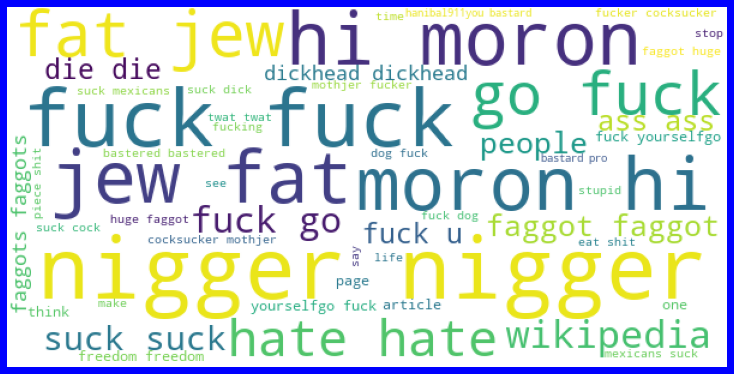

['nigger nigger', 'fuck fuck', 'moron hi', 'hi moron', 'jew fat', 'fat jew', 'go fuck', 'hate hate', 'wikipedia', 'fuck go', 'suck suck', 'faggot faggot', 'people', 'ass ass', 'fuck u', 'die die', 'dickhead dickhead', 'faggots faggots', 'fuck yourselfgo', 'yourselfgo fuck', 'article', 'one', 'think', 'page', 'freedom freedom', 'mothjer fucker', 'fucker cocksucker', 'twat twat', 'cocksucker mothjer', 'bastered bastered', 'stupid', 'huge faggot', 'faggot huge', 'life', 'make', 'piece shit', 'suck dick', 'time', 'fucking', 'say', 'suck cock', 'stop', 'fuck dog', 'see', 'mexicans suck', 'dog fuck', 'suck mexicans', 'eat shit', 'hanibal911you bastard', 'bastard pro']


In [15]:
word_count(abuse)

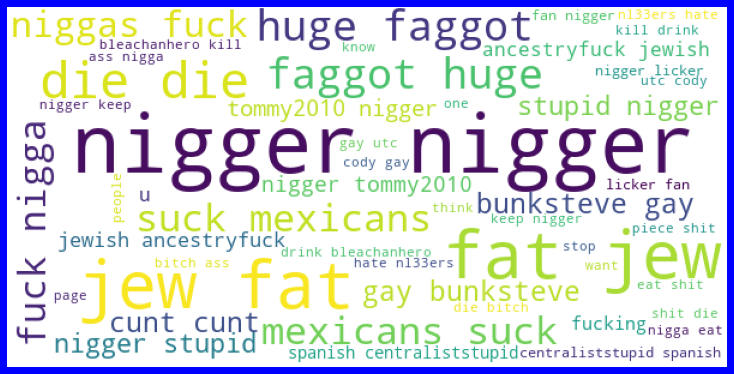

['nigger nigger', 'jew fat', 'fat jew', 'die die', 'huge faggot', 'faggot huge', 'mexicans suck', 'suck mexicans', 'fuck nigga', 'niggas fuck', 'bunksteve gay', 'gay bunksteve', 'cunt cunt', 'stupid nigger', 'nigger stupid', 'tommy2010 nigger', 'nigger tommy2010', 'jewish ancestryfuck', 'ancestryfuck jewish', 'u', 'fucking', 'spanish centraliststupid', 'centraliststupid spanish', 'fan nigger', 'nigger licker', 'licker fan', 'kill drink', 'drink bleachanhero', 'bleachanhero kill', 'people', 'keep nigger', 'nigger keep', 'know', 'bitch ass', 'page', 'eat shit', 'think', 'ass nigga', 'shit die', 'die bitch', 'nigga eat', 'piece shit', 'hate nl33ers', 'nl33ers hate', 'want', 'cody gay', 'gay utc', 'utc cody', 'stop', 'one']


In [16]:
word_count(loathe)

In [17]:
#word_count(normal)

In [19]:
emotion_list=[]
with open('emotions.txt','r') as file:
    for line in file:
        clear_line=line.replace('\n','').replace(',','').replace("'",'').strip()
        word,emotion=clear_line.split(':')
        
        if word in ds_train['cleaned_comments'][42]:
            emotion_list.append(emotion)
print('emotions from text\n',emotion_list,'\n\n')
w=Counter(emotion_list)
print('counter of each emotion \n',w)

emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 5, 'highly_malignant': 5, 'rude': 4, 'loathe': 4, 'threat': 3, 'abuse': 3})


In [20]:
op_dict={}
for comment in ds_test['comment_text']:
    emotion_list=[]
    with open('emotions.txt','r') as file:
        for line in file:
            clear_line=line.replace('\n','').replace(',','').replace("'",'').strip()
            word,emotion=clear_line.split(':')
        
            if word in comment.split():
                emotion_list.append(emotion)
    print('emotions from text\n',emotion_list,'\n\n')
    w=Counter(emotion_list)
    print('counter of each emotion \n',w)
    op_dict[comment]=emotion_list

emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'threat': 3, 'highly_malignant': 2, 'abuse': 2, 'loathe': 2, 'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_mali

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malign

 ['malignant', 'malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


coun

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emot

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'malignant': 1, 'rude': 1, 'abuse': 1})
emotions

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emoti

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emoti

 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'threat', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', '


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of eac

emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_mal

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 3, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'loathe': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from tex

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'h

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


co

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignan

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each e

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()

 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 3, 'loathe': 3, 'rude': 2, 'threat': 2, 'malignant': 1, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text


emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from

emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emoti

emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 2, 'loathe': 2, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['maligna

 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse'] 


co

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from te

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1,

emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 

 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant

 Counter({'malignant': 3, 'abuse': 3, 'rude': 2, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 4, 'rude': 4, 'threat': 4, 'abuse': 3, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'high

emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from tex

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'lo

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 4, 'abuse': 3, 'malignant': 2, 'rude': 2, 'threat': 2, 'highly_malignant': 1})
emotions from text


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emot

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['maligna

emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'abuse': 4, 'loathe': 4, 'malignant': 3, 'rude': 3, 'threat': 3})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'highly_malignant': 4, 'abuse': 4, 'loathe': 4, 'threat': 3, 'rude': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({

emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 4, 'highly_malignant': 3, 'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
e

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions fr

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
e

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'threat': 3, 'loathe': 3, 'malignant': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'rude': 2, 'loathe': 2, 'abuse': 1})

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


cou

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1,

 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse'

 ['highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'threat': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'loathe': 2, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_m

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1,

emotions from text
 ['malignant', 'highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'mali

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 

 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter o

 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counte

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each 

emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each em

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions f

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotion

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'rude': 2, 'malignant': 1, 'threat

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'mali

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 3})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emot

emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'highly_malignant': 4, 'abuse': 4, 'loathe': 4, 'threat': 3, 'rude': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'threat': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counte

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'highly_malignant', 'rud

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant'

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


cou

 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of eac

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'threat', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'loathe': 3, 'malignant': 2, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotio

emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text


emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 []

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant'

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'highly_malignant': 3, 'abuse': 3, 'rude': 2, 'threat': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counte

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
em

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignan

emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fro

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emoti

 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 4, 'malignant': 3, 'loathe': 3, 'highly_malignant': 2, 'rude': 2, 'threat': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 3, 'abuse': 3, 'malignant': 2, 'highly_malignant': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emo

 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rud

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'malignant': 1, 'rude': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fro

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 2, 'abuse': 2, 'malignant': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 C

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe', '

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emo

emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


c

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'loathe': 2, 'malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'abuse': 2, 'loathe': 2, 'malignant': 1, 'r

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fro


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 




 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'threat': 2, 'malignant': 1, 'highly_malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant', 'malignant', 'highly_m

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of e

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, '

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 []

counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 



 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 4, 'malignant': 3, 'loathe': 3, 'rude': 2, 'threat': 2, 'highly_malignant': 1})
emotions from text
 ['malignant

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'th

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emoti

emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat',

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, '

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'h

 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'abuse', 'abuse', 'loathe'] 


counter of ea

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malig

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 




 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Count

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abus

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fro

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion

emotions from text
 ['highly_malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 

 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


co

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', '

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['mali

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


c

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['h

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 

 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from tex

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
em

emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each e

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each e

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'threat': 2, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


cou

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_maligna

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'maligna

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'rude': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 ['m

emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


co

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emot

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of ea

emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1, 'loathe

emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 

 ['highly_malignant', 'highly_malignant', 'highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'loathe': 2, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'hig

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from

 ['highly_malignant', 'highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emot

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 2, 'threat': 2, 'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'m

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotion

 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emot

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


co

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 4, 'rude': 3, 'loathe': 3, 'malignant': 2, 'highly_malignant': 2, 'threat': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Co

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 3, 'malignant': 2, 'abuse': 2, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_maligna

 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each e

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter

emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loat

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'high

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Cou

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each 

emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of e

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse', 'abuse', 'loathe'] 


cou

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each 

 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant'

 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of eac

emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'highly_malignant': 1, 'rude': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'highly_malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})


 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_mali

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'a

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions fro

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
e

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'threat': 2, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['maligna

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


cou


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'highly_malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2, 'malignant': 1})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['mali

 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant'

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


coun

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 []

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_maligna

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2,

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of ea

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of e

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_mal

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse'] 


c

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 6, 'malignant': 5, 'abuse': 5, 'rude': 4, 'threat': 3, 'loathe': 3})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malign

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Co

 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'loathe': 3, 'rude': 2, 'threat': 2, 'abuse': 2})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 C

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions f

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 C

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emo

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter o

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1,

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of eac

counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter(

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'loathe': 2, 'malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threa

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['maligna

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'rude': 3, 'malignant': 2, 'abuse': 2, 'highly_malignant': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'high

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Cou

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 4, 'rude': 3, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 




 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'malignant', 'h

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'threat': 3, 'loathe': 3, 'highly_malignant': 2, 'abuse': 2, 'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Coun

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', '

 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'r

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'ru

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


count

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'hi

 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotio

 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'highly_malignant': 4, 'rude': 3, 'abuse': 3, 'threat': 2, 'loathe': 2})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'highly_malignant': 4, 'rude': 3, 'abuse': 3, 'threat': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 

 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions f

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of eac

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2, 'highly_malignant': 1})

 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'threat': 1, 'abuse': 1, 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 6, 'malignant': 3, 'rude': 2, 'threat': 2, 'loathe': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


co

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'loathe': 5, 'malignant': 4, 'rude': 3, 'threat': 3, 'abuse': 3})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant',

emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
e

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'loathe': 2, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'threat': 3, 'rude': 2, 'malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 


 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['m

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()


 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emoti

 ['malignant', 'malignant', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 6, 'abuse': 4, 'loathe': 4, 'malignant': 3, 'rude': 2, 'threat': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'abuse': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emot

 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse':

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'th

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 




 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 




 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 []

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'loathe': 3, 'rude': 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 []

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 4, 'threat': 3, 'rude': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'abuse': 3, 'loathe': 3, 'malignant': 2, 'rude': 2, 'threat': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Co

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emo

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 []


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'loathe': 2, 'malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'threat': 3, 'rude': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'a

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'h

 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'abuse': 3, 'loathe': 3, 'malignant': 2, 'rude': 2, 'threat': 2})
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from te

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'abuse': 2, 'malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from te

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'threat': 3, 'loathe': 3, 'malignant': 2, 'rude': 2, 'abuse': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


count

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'mali

 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Count

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', '

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emo

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highl

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 2, 'threat': 2, 'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 

 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Coun

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'abuse'

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of eac

 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 




 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter 

emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 3, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
e

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 2, 'malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emot

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 C

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'abuse': 2, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counte

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'r

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of eac

 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'malignan

 ['highly_malignant', 'highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'loathe': 2, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_m

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emot


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignan

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emoti

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotion

 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fr

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emo

emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'ru

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threa

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', '

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'threat': 2, 'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emo

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 5, 'highly_malignant': 5, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loat

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'threat': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


count

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abu

 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fr

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of eac

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'loathe': 2, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'highly_malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emoti

 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions f

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 



emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


coun

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


c

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highl

 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'threat', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'loathe': 2, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


co

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text


 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


count


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emoti


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emoti

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()


 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_ma

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emo

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat

 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'thr

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Cou

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotion

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant'


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'rude': 3, 'abuse': 3, 'loathe': 2, 'threat': 1})
emotions from text
 ['malignant', '

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 



 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 C

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each e

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'threat': 2, 'abuse': 2, 'highly_malignant': 1, 'rude': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


count

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_m

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'abuse': 2, 'malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'hig

 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions f

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 [

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant':

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 6, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emo

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'threat': 2, 'malignant': 1, 'highly_malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat',

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Coun

 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter(

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter(

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of eac

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of

counter of each emotion 
 Counter({'highly_malignant': 4, 'abuse': 3, 'loathe': 3, 'malignant': 2, 'rude': 2, 'threat': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threa

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


co

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'highly_malignant', 't

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'abuse': 2, 'loathe': 2, 'malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from tex

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_mal

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_maligna

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 2, 'threat': 2, 'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'threat': 2, 'rude': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 



emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 []

 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text


 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'threat'] 


counter of each emotion 
 Counter({'threat': 3, 'highly_malignant': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'threat', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'loathe': 2, 'abuse': 1})
emotions from text
 ['highly_malignant', 'thr

 ['malignant', 'malignant', 'highly_malignant', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, '

emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'thr

emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'abuse': 3, 'rude': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 2, 'abuse': 2, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter(

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


co

 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
e

 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from te

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 




counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotio

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counte

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'malignant': 2, 'highly_malignant': 2, 'abuse': 2, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fr

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'threat': 2, 'malignant': 1, 'highly_malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Coun

counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 4, 'highly_malignant': 3, 'rude': 3, 'loathe': 3, 'malignant': 2, 'threat': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Cou

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotion

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from 

 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 

counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from te

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each e

 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 3, 'loathe': 3, 'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loa

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text

emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fro

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_ma

emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 


 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter o

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter(

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['loathe'] 


counter of each e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Cou

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 



emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotion

 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotion

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 []

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()


emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'abuse': 2, '

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 C

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'highly_malignant', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


coun

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotion

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 3, 'threat': 3, 'malignant': 2, 'highly_malignant': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 




emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emo

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'high

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'ru

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'loathe': 2, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotio

 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'abuse': 2, 'rude': 1, 'threat': 1, 'loathe': 1})
emo

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'threat': 2, 'rude': 1, 'abuse': 1, 'loathe': 1})


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions f

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fro

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})


 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'threat': 3, 'loathe': 3, 'malign

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'loathe': 2, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'h

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of eac

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 2, 'abuse': 2, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['highly_malignant', 'threat', 'a

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abu

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 5, 'highly_malignant': 4, 'abuse': 4, 'rude': 3, 'threat': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', '

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotio

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abus


counter of each emotion 
 Counter({'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions fr

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'threat': 2, 'm

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each e

 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Co

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from te

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'abuse': 2, 'malignant': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'maligna

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emoti

 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 

 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse'

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each em

 ['malignant', 'malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loa

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of eac

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse', 'abuse'] 


counter of each 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'maligna

emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignan

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 6, 'malignant': 3, 'threat': 3, 'loathe': 3, 'rude': 2, 'abuse': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malig

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each em

emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fr

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


cou

 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', '

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text


 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of ea

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'abuse': 2, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


coun

 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'threat': 2, 'malignant': 1, 'highly_malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotion

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 3, 'malignant': 2, 'highly_malignant': 2, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'loathe': 1})
emoti

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'abuse': 2, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'threat': 3, 'loathe': 3

 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'ru

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter o

 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emot

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Cou

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'h

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 




emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counte

 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter(

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of e

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abus

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emot

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'rude': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'abuse': 4, 'rude': 3, 'threat': 2, 'loathe': 2, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_m

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'highly_malignant': 4, 'abuse': 3, 'rude': 2, 'threat': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of eac

 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude

 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'rude': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_ma

emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emo

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loat

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'loathe': 2, 'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Cou

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from tex

 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fr

 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counte

counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counte

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 3, 'abuse': 3, 'loathe': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['mali

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rud

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'hi

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
e

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat

 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emo

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['mal

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 1, 'threat': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotion

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emot

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of

 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 




emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Coun

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 5, 'malignant': 4, 'highly_malignant': 4, 'threat': 4, 'abuse': 3, 'rude': 2})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counte

 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter(

 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Co

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'rude': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter

 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 5, 'rude': 4, 'malignant': 3, 'loathe': 3, 'highly_malignant': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'abuse': 3, 'loathe': 3, 'malignant': 2, 'rude': 2, 'threat': 2})
emotions from text
 ['highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 



 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['mal

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 




 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'mali

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 ['malignant', 'rude', 'threat'

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from te

 ['highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 2, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotio

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'high

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emo

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse']

 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', '

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'threat': 3, 'highly_malignant': 2, 'loathe': 2, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 1, 'loathe': 1})
emot

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fro

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Cou

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1,

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from tex

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'ab

 Counter({'highly_malignant': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from

 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'abuse': 2, 'loathe': 2, 'malignant':

 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat', 'threat'] 


counter of each emotion 
 Counter({'threat': 2, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1}

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'abuse': 2, 'loathe': 2, 'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highl

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Cou

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse':

emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 3, 'rude': 3, 'threat': 3, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


cou

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'rude': 3, 'abuse': 3, 'threat': 2, 'loathe': 2, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from te

 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


co

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each 

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abus

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text


 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'hig

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'thr

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


co

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Count

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 

 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text

 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 3, 'threat': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'rude': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emo

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emo

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emoti

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of eac

 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fr

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 2, 'abuse': 2, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat'

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text


emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emo

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
em

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, '

 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['m

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emoti

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'threat', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'loathe': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2})
emotions from text
 

emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loa

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'threat', 'ab

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_maligna

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotio

emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each em

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highl

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Count

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions f

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of ea

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant',

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'loathe'] 


counter

emotions from text
 ['malignant', 'highly_malignant', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 C

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 5, 'highly_malignant': 4, 'rude': 3, 'abuse': 3, 'threat': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counte

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emot

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotio


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fr

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each em

 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'rude': 4, 'abuse': 4, 'highly_malignant': 3, 'threat': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


count

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emot

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malign

 ['malignant', 'highly_malignant', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each em

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'rude': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_m

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 


 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 6, 'malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from tex

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant':

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['rude',

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fr

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_ma

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 C

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abu

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'hi

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


co

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant':

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter o

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'threat': 2, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignan

 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threa

 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotio

counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


cou

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'threat': 3, 'abuse': 3, 'loathe': 3, 'rude': 2})
emotions f

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Count

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'thre


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emot

 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'highly_malignant': 3, 'rude': 3, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 4, 'rude': 3, 'threat': 3, 'loathe': 3, 'abuse': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of eac

 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emo

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


co

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highl

counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe',

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, '

emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'highly_malignant': 4, 'rude': 3, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text


 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emot

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 4, 'threat': 3, 'abuse': 3, 'loathe': 3, 'rude': 2})
emotions 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignan

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abus

 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text

 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 6, 'malignant': 2, 'loathe': 2, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'th

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emot

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loath

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abu

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counte

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'highly_malignant'

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'rude': 4, 'abuse': 4, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emoti

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 1, 'threat': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 C

emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text


 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', '

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 

counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_m

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'highly_malignant': 2, 'abuse': 2, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 2, 'malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malig

counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude'

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Count

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fro

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of eac

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Count

 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'thr

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Cou

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emoti

 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'threat': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counte

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly

 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each e

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 3, 'rude': 3, 'threat': 2, 'abuse': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counte

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 

emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of e

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 3, 'malignant': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2,

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counte

 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude'

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant':

 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 5, 'highly_malignant': 4, 'rude': 4, 'abuse': 4, 'threat': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loa

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emot

 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
em

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emo

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emoti

 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'th

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emot

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter o

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emoti

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignan

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter

emotions from text
 ['malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'threat': 2, 'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 

emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


coun

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'hi

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emot

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emot

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions fr

 ['highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 1, 'threat': 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


cou

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'highly_malignant': 3, 'abuse': 3, 'rude': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'loathe': 4, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each 

 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant'

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


cou

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude':

 Counter({'highly_malignant': 5, 'malignant': 3, 'threat': 2, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


coun

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 



emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'loathe': 3, 'rude': 2, 'threat': 2, 'abuse': 2})
emotions from text
 ['malignant', 'malignant', 'malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['mal

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counte

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Coun

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emo

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'ab

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each e

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


coun

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 



counter of each emotion 
 Counter({'malignant': 6, 'rude': 5, 'abuse': 5, 'highly_malignant': 3, 'threat': 3, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
e

 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_mal

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each em

emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 



emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


co

 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 9, 'malignant': 6, 'rude': 6, 'abuse': 5, 'threat': 4, 'loathe': 3})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
em

 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each e

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counte

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'threat': 2, 'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emo

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'threat'] 


counte

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 

 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fro

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Coun

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malig

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c

emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse'

counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


co

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emoti

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Count

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 5, 'highly_malignant': 5, 'abuse': 4, 'loathe': 4, 'rude': 3, 'threat': 3})
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotio

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse',

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emoti

 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each e

 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malign

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['abuse'] 


counter of each emotion 
 Counter({'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignan

emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'rude': 1, 'loathe':

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from tex

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_ma

 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 




emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions 

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emoti

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each e

counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', '

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'highly_malignant', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_m

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'highly_malignant': 1, 'threat': 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions 

emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'highly_malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe'

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'loathe': 4, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_mali

emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter(

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 C

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Count

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 C

emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emo

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counte

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'highly_malignant': 4, 'rude': 3, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'rude': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignan

 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'mali

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse'

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter o

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threa

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of ea

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Coun

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 1, 'rude': 1, 'abuse': 1

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counte

 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abu

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emoti

 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emo

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse'] 


counter of 

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malign

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions 

emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'threat': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fr

emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions f

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 5, 'highly_malignant': 5, 'rude': 4, 'abuse': 4, 'threat': 3, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emoti

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotio

emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of e

 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threa

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c

 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'threat': 2, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


emotions from text
 ['malignant', 'malignant', 'malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 3, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emot

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'rude': 3, 'abuse': 3, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emoti

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from tex

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat'

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emoti

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emoti

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emot

emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'th

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'rude': 3, 'malignant': 2, 'highly_malignant': 2, 'threat': 2, 'abuse': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'highly

 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emot

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 

counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 []

 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 



counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_ma

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['loathe'] 


c

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter(

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 



emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat', 'loathe'] 


counter of each emotion 
 Counter({'threat': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat'

 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fro

 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'abuse': 2, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 6, 'malignant': 3, 'abuse': 3, 'rude': 2, 'threat': 2, 'loathe': 1})
emotions from text
 ['highl

emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'rude': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
e

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions f

 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat'

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'r

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 C

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'abuse': 3, 'loathe': 3, 'rude': 2, 'malignant': 1, 'threat': 1})
e

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


count

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, '

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 6, 'malignant': 4, 'rude': 2, 'loathe': 2, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 



emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 



 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emo

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()

emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 




 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from tex

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 't

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each em


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'loathe': 2, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter o

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each 

emotions from text
 ['malignant', 'malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'abuse': 3, 'rude': 2, 'loathe': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'threat': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'threat': 2, 'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
e

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 3, 'rude': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


coun

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counte

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions

 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


coun

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotio

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emo

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotio

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1

 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from tex

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 

emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'abuse'] 


counter of each 

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counte

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', '

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat

emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignan

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
e

emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions

emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Cou

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 3, 'malignant': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of eac

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'hig

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 3, 'rude': 2, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each e

emotions from text
 ['malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'threat': 2, 'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [

emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loa

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fr

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
e

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


count

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 

emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'threat': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_m

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()


 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'abuse': 2, 'loathe': 2, 'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emo

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from te

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fr

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text


 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant'

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})


emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, '

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude'

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abus

 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Co

 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_m

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 C

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


coun

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text



counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe'

 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counte

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counte

emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each em

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2, 'high

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion

 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'ru

emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highl

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'loathe': 2, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


coun

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1,

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emoti

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, '

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1}

 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 2, 'rude'

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malig

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_m

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counte

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'threat': 2, 'malignant': 1, 'hi

emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emot

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 




emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 3, 'loathe': 3, 'rude': 2, 'threat': 2, 'malignant': 1, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loa

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Cou

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emoti

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 3, 'malignant': 2, 'highly_malignant': 2, 'threat': 2, 'loathe': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude',

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions f

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emo


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'highly_malignant', 'threat', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1,

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
e

emotions from text
 ['malignant', 'highly_malignant', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each em

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter(

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter

emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 3, 'loathe': 3, 'malig

 ['malignant', 'malignant', 'malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'abuse': 2, 'loathe': 2, 'malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 6, 'malignant': 5, 'rude': 5, 'loathe': 5, 'highly_malignant': 4, 'threat': 3})
emotions f

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 3, 'malignant': 2, 'highly_malignant': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_maligna

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 2, 'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counte

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'threat': 3, 'loathe': 3, 'highly_malignant': 2, 'abuse': 2, 'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emot

 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter(

emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
em

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'threat': 2, 'abuse': 2, 'rude': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'rude'

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'abuse': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'r

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'rude': 2, 'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotio

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emoti

counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 []

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from 

emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotion

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotio

emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'm

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'hi

 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emo

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'threat'] 


counter of each emotion 
 Counter({'threat': 2, 'highly_malignant': 1, 'rude': 1})
emotions fr

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fr

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter(

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'threat': 3, 'rude': 2, 'abuse': 2, 'loathe': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of 

emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'threat': 2, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of e

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'abuse': 2, 'loathe': 2, 'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', '

emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of 

 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Co

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of eac

emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


co

emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 



 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 3, 'abuse': 2, 'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant':

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1})
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'loathe': 2, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 



counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 2, 'malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'hig

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


cou

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rud

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of eac

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emot

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each em

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emo

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emoti

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of ea

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counte

 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 Counter({'malignant': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 2, 'threat': 2, 'malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emo

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant':

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Coun

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant'] 


counter of each emotion 
 

emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 6, 'a

 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 3, 'loathe': 3, 'malignant': 2, 'rude': 2, 'threat': 2, 'highly_malignant': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 2, 'abuse': 2, 'loathe': 2, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'rude', 'threat', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 5, 'highly_malignant': 4, 'rude': 4, 'abuse': 4, 'threat': 3, 'loathe': 3})
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of ea

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Cou

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c

emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'rude': 3, 'abuse': 3, 'loathe': 3, 'malignant': 2, 'highly_malignant': 2, 'threat': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'maligna

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant'] 


counter of each emotion 
 Counter({'malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'ru

emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2, 'highly_malignant': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 C

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 5, 'malignant': 3, 'rude': 3, 'threat': 2, 'loathe': 2, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 6, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text

 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'loathe'

 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 

emotions from text
 ['malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1})
emotions from text
 ['malignant', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'ab

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 3, 'malignant': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions 

 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'rude': 2, 'threat': 2, 'malignant': 1, 'abuse': 1})
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'thre

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'threat': 2, 'loathe': 2, 'rude': 1, 'abuse': 1})
emot


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'abuse': 3, 'loathe': 3, 'malignant': 2, 'rude': 2, 'threat': 2, 'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Count

 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 2, 'highly_malignant': 2, 'rude': 2, 'threat': 2, 'abuse': 2, 'loathe': 2}

emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter(

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['ma

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


c

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 ['highly_malignant', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'loathe': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'abuse', 'abuse'] 


counter of each emotion 
 Counter({'rude': 3, 'malignant': 2, 'abuse': 2, 'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


count

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emo

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'rude': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['abuse'] 


counter of each emotion 
 Counter({'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'highly_malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1})
emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


c

 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 3, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['threat'] 


counter of each emotion 
 Counter({'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'threat': 2, 'abuse': 2, 'rude': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'loathe': 2, 'highly_malignant': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emoti

 ['highly_malignant', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'threat': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe', 'loathe'] 


counter of each em

emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'malignant': 3, 'loathe': 2, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 




emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 5, 'highly_malignant': 4, 'rude': 2, 'abuse': 2, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of ea

 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'loathe': 3, 'mal

emotions from text
 ['malignant', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abu

emotions from text
 ['rude', 'abuse'] 


counter of each emotion 
 Counter({'rude': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 

emotions from text
 ['malignant', 'highly_malignant', 'rude', 'rude', 'threat', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'rude': 2, 'threat': 2, 'malignant': 1, 'highly_malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'highly_malignant': 2, 'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions fro

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 3, 'malignant': 2, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'highly_malignant': 2, 'abuse': 2, 'rude': 1, 'threat': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 []

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 3, 'loathe': 3, 'highly_malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from t

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 ['malignant', 'rude', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'abuse'

 ['highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 1})
emotions from text
 ['malignant', 'rude', 'threat', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'highly_malignant'] 


counter of each emotion 
 Counter({'highly_malignant': 2})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highly_malignant': 1, 'r

 [] 


counter of each emotion 
 Counter()
emotions from text
 ['loathe'] 


counter of each emotion 
 Counter({'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'rude', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'abuse', 'loathe'] 


counter of each emotion 
 Counter({'malignant': 4, 'highly_malignant': 4, 'rude': 3, 'abuse': 3, 'threat': 2, 'loathe': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from tex

emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'highly_malignant', 'rude', 'threat', 'abuse'] 


counter of each emotion 
 Counter({'malignant': 1, 'highly_malignant': 1, 'rude': 1, 'threat': 1, 'abuse': 1})
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 [] 


counter of each emotion 
 Counter()
emotions from text
 ['malignant', 'malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'highly_malignant', 'rude', 'threat', 'threat', 'abuse', 'abuse', 'loathe', 'loathe', 'loathe'] 


counter of each emotion 
 Counter({'highly_malignant': 4, 'loathe': 3, 'malignant': 2, 'threat': 2, 'abuse': 2, 'rude': 1})
emotions from text
 ['highly_malignant', 'rude', 'threat'] 


counter of each emotion 
 Counter({'highl

In [21]:
op_dict

{'yo bitch ja rule is more succesful then you ll ever be whats up with you and hating you sad mofuckas i should bitch slap ur pethedic white faces and get you to kiss my ass you guys sicken me ja rule is about pride in da music man dont diss that shit on him and nothin is wrong bein like tupac he was a brother too fuckin white boys get things right next time ': ['malignant',
  'highly_malignant',
  'highly_malignant',
  'rude',
  'threat',
  'threat',
  'threat',
  'abuse',
  'abuse',
  'loathe',
  'loathe'],
 ' from rfc the title is fine as it is imo ': [],
 ' sources zawe ashton on lapland ': [],
 ' if you have a look back at the source the information i updated was the correct form i can only guess the source hadn t updated i shall update the information once again but thank you for your message ': [],
 'i don t anonymously edit articles at all ': [],
 'thank you for understanding i think very highly of you and would not revert without discussion ': [],
 'please do not add nonsense 

In [23]:
ds_train

,comment_text,malignant,highly_malignant,rude,threat,abuse,loathe,cleaned_comments,comment_cat
0,explanation why the edits made under my userna...,0,0,0,0,0,0,explanation edits made username hardcore metal...,0
1,d aww he matches this background colour i m se...,0,0,0,0,0,0,aww matches background colour seemingly stuck ...,0
2,hey man i m really not trying to edit war it s...,0,0,0,0,0,0,hey man really trying edit war guy constantly ...,0
3,more i can t make any real suggestions on imp...,0,0,0,0,0,0,make real suggestions improvement wondered sec...,0
4,you sir are my hero any chance you remember wh...,0,0,0,0,0,0,sir hero chance remember page,0
...,...,...,...,...,...,...,...,...,...
159566,and for the second time of asking when your v...,0,0,0,0,0,0,second time asking view completely contradicts...,0
159567,you should be ashamed of yourself that is a ho...,0,0,0,0,0,0,ashamed horrible thing put talk page 128 61 19 93,0
159568,spitzer umm theres no actual article for prost...,0,0,0,0,0,0,spitzer umm theres actual article prostitution...,0
159569,and it looks like it was actually you who put ...,0,0,0,0,0,0,looks like actually put speedy first version d...,0


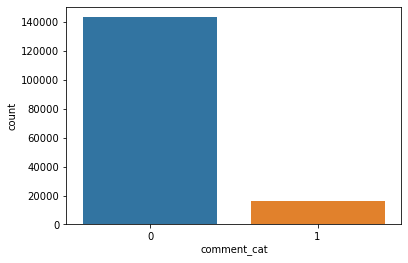

In [24]:
import seaborn as sns
sns.countplot(ds_train['comment_cat'])

In [25]:
ds_train['length']=ds_train.comment_text.str.len()
ds_train['cleaned_length']=ds_train.cleaned_comments.str.len()

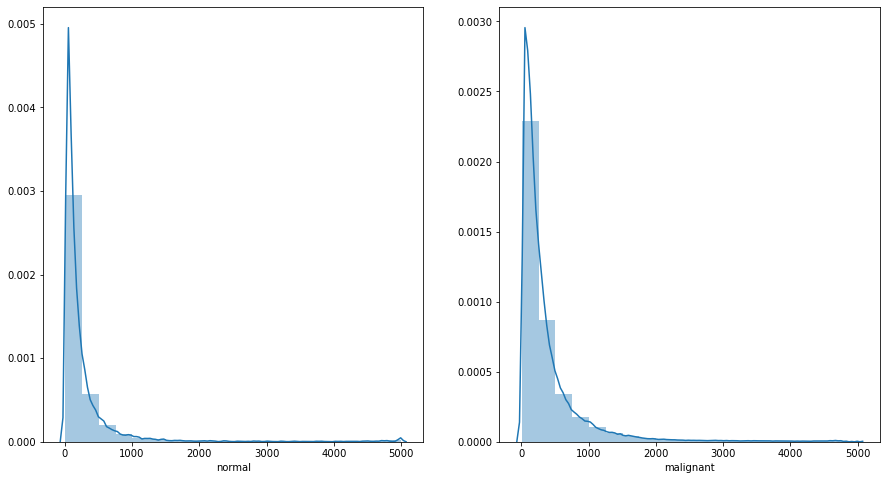

In [26]:
#0 stands for normal and 1 stands for malignant
f,ax=plt.subplots(1,2,figsize=(15,8))
sns.distplot(ds_train[ds_train['comment_cat']==1]['length'],bins=20,ax=ax[0])

sns.distplot(ds_train[ds_train['comment_cat']==0]['length'],bins=20,ax=ax[1])
ax[0].set_xlabel('normal')
ax[1].set_xlabel('malignant')
plt.show()

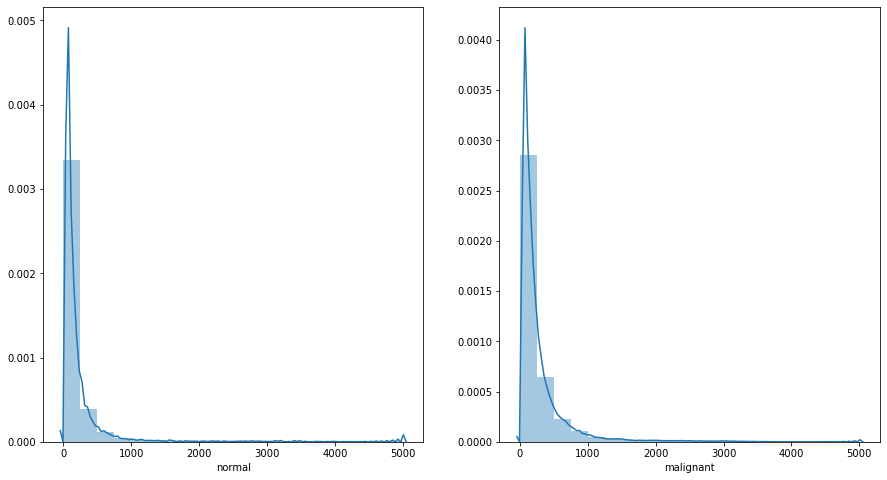

In [27]:
f,ax=plt.subplots(1,2,figsize=(15,8))
sns.distplot(ds_train[ds_train['comment_cat']==1]['cleaned_length'],bins=20,ax=ax[0])

sns.distplot(ds_train[ds_train['comment_cat']==0]['cleaned_length'],bins=20,ax=ax[1])
ax[0].set_xlabel('normal')
ax[1].set_xlabel('malignant')
plt.show()

In [28]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
ds_train.dropna(inplace=True)


In [29]:
tf_vec=TfidfVectorizer()
features=tf_vec.fit_transform(ds_train['cleaned_comments'])
x=features
y=ds_train['comment_cat']
y=y.astype('int')

In [30]:
features.shape

(159548, 189731)

In [31]:
NB=MultinomialNB()
x_train,x_test,y_train,y_test=train_test_split(x,y,random_state=42)
NB.fit(x_train,y_train)
y_pred_nb=NB.predict(x_test)
print(accuracy_score(y_test,y_pred_nb))

0.917065710632537


In [32]:
print(classification_report(y_test,y_pred_nb))
print(confusion_matrix(y_test,y_pred_nb))

              precision    recall  f1-score   support

           0       0.92      1.00      0.96     35819
           1       0.99      0.19      0.32      4068

    accuracy                           0.92     39887
   macro avg       0.95      0.59      0.64     39887
weighted avg       0.92      0.92      0.89     39887

[[35810     9]
 [ 3299   769]]


Text(0.5, 0.98, 'Comparision of NB results')

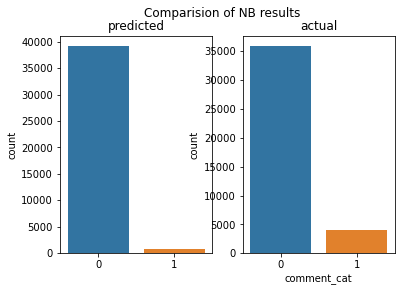

In [33]:
plt.subplot(1, 2, 1)
sns.countplot(y_pred_nb)
plt.title('predicted')
plt.subplot(1, 2, 2)
sns.countplot(y_test)
plt.title('actual')
plt.suptitle('Comparision of NB results')

In [34]:
from sklearn.tree import DecisionTreeClassifier
dtc=DecisionTreeClassifier()
dtc.fit(x_train,y_train)
y_pred_dtc=dtc.predict(x_test)
print(accuracy_score(y_test,y_pred_dtc))

0.9346905006643769


In [35]:
print(classification_report(y_test,y_pred_dtc))
print(confusion_matrix(y_test,y_pred_dtc))

              precision    recall  f1-score   support

           0       0.97      0.96      0.96     35819
           1       0.67      0.71      0.69      4068

    accuracy                           0.93     39887
   macro avg       0.82      0.84      0.83     39887
weighted avg       0.94      0.93      0.94     39887

[[34382  1437]
 [ 1168  2900]]


Text(0.5, 0.98, 'Comparision of DTC results')

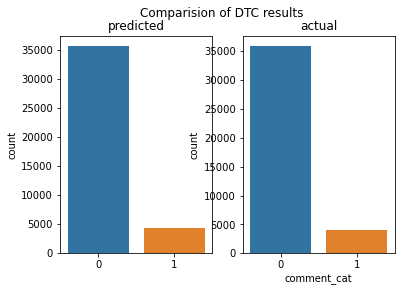

In [36]:
plt.subplot(1, 2, 1)
sns.countplot(y_pred_dtc)
plt.title('predicted')
plt.subplot(1, 2, 2)
sns.countplot(y_test)
plt.title('actual')
plt.suptitle('Comparision of DTC results')

In [37]:
from sklearn.ensemble import RandomForestClassifier
rfc=RandomForestClassifier()
rfc.fit(x_train,y_train)
y_pred_rfc=rfc.predict(x_test)
print(accuracy_score(y_test,y_pred_rfc))

0.9434903602677565


In [38]:
print(classification_report(y_test,y_pred_rfc))
print(confusion_matrix(y_test,y_pred_rfc))

              precision    recall  f1-score   support

           0       0.95      0.98      0.97     35819
           1       0.81      0.58      0.68      4068

    accuracy                           0.94     39887
   macro avg       0.88      0.78      0.82     39887
weighted avg       0.94      0.94      0.94     39887

[[35277   542]
 [ 1712  2356]]


Text(0.5, 0.98, 'Comparision of RFC results')

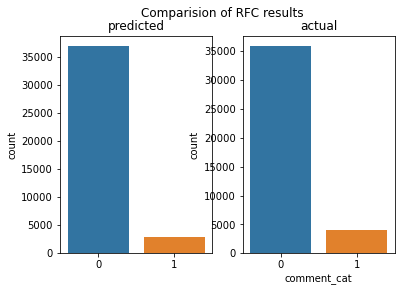

In [39]:
plt.subplot(1, 2, 1)
sns.countplot(y_pred_rfc)
plt.title('predicted')
plt.subplot(1, 2, 2)
sns.countplot(y_test)
plt.title('actual')

plt.suptitle('Comparision of RFC results')

In [40]:
ds_test.isnull().sum()

comment_text          0
cleaned_comments    113
dtype: int64

In [41]:
ds_test.dropna(inplace=True)

In [42]:
tf_vec=TfidfVectorizer()
features=tf_vec.fit_transform(ds_train['cleaned_comments'])
features=tf_vec.transform(ds_test['cleaned_comments'])

In [43]:
y_pred_dtc_test=dtc.predict(features)


In [44]:
pd.DataFrame(y_pred_dtc_test).to_csv('test_set_preds')